In [29]:
import pandas as pd
from Scaling import normalize, standardize
import plotly.express as px
from sklearn.cluster import KMeans
from matplotlib import pyplot as plt
import numpy as np


df2015 = pd.read_csv('../data/kaasa/kaasa_2015.csv', index_col=None, header=0)
df2016 = pd.read_csv('../data/kaasa/kaasa_2016.csv', index_col=None, header=0)
df2017 = pd.read_csv('../data/kaasa/kaasa_2017.csv', index_col=None, header=0)
df2018 = pd.read_csv('../data/kaasa/kaasa_2018.csv', index_col=None, header=0)
df2019 = pd.read_csv('../data/kaasa/kaasa_2019.csv', index_col=None, header=0)
df2020 = pd.read_csv('../data/kaasa/kaasa_2020.csv', index_col=None, header=0)
df2021 = pd.read_csv('../data/kaasa/kaasa_2021.csv', index_col=None, header=0)

files = [df2015, df2016, df2017, df2018, df2019, df2020, df2021]

df_tot = pd.concat(files, axis=0, ignore_index=True)
df_tot['date_time'] = pd.to_datetime(df_tot['date_time'])

data_kmeans = df_tot.loc[:,[ 'velocity', 'sin_time','cos_time']]


X_S = standardize(data_kmeans, ['velocity', 'sin_time','cos_time']) # standarize the data
df_vel = normalize(X_S, ['velocity', 'sin_time','cos_time'],-1,1) # standarize the data


In [30]:

def elbow_method(df):
    scores = []
    for n_clusters in range(1, 21):
        kmeans = KMeans(n_clusters=n_clusters,
                        max_iter=1000, n_init=10).fit(df)
        scores.append(kmeans.inertia_)

    plt.figure(figsize=(8, 4))
    plt.plot(range(1, 21), scores)
    plt.title('Elbow method - Velocity, sine time and cosine time')
    plt.xlabel('Number of clusters')
    plt.xticks(range(2, 21, 2), fontsize=10)
    plt.ylabel('Score')
    plt.show()

# 3 dimention K-means


def kmeans_3d(df, n_clusters, feature):
    kmeans = KMeans(n_clusters=n_clusters, n_init=10)
    kmeans.fit(df)
    clusters = kmeans.labels_
    df['cluster'] = clusters
    fig = px.scatter_3d(df, x='sin_time', y='cos_time',
                        z=feature, color='cluster', opacity=1)
    fig.update_traces(marker=dict(size=6, line=dict(
        width=1, color='white')), selector=dict(mode='markers'))
    fig.update_layout(margin=dict(l=20, r=20, t=20, b=20),  width=800,  # set the width of the figure
                      height=500)
    fig.show()
    return clusters


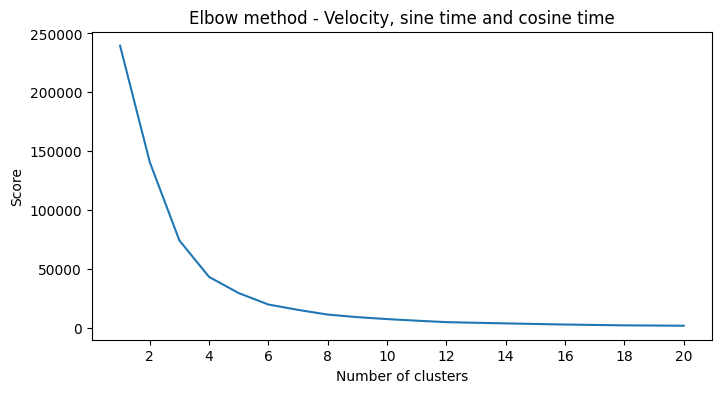

In [3]:


elbow_method(df_vel)


In [31]:
cluster_vel = kmeans_3d(df_vel, 4, 'velocity')
